In [1]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import glob
import math
import random
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Helper function to display multiple images in a plot
def display_images(images, rows, cols, size, title, subtitles):
    %matplotlib inline
    fig = plt.figure(figsize = size)
    c = 0
    sz = len(images)
    for i in range(rows):
        for j in range(cols):
            if sz == c:
                break
            ax1 = fig.add_subplot(rows, cols, c + 1)
            ax1.imshow(images[c], cmap = 'gray')
            ax1.set_title(subtitles[c], fontsize = 20)
            c = c + 1
    plt.show()
    # Un comment the below line and comment the above line to save and display
    #plt.savefig('part2.png')

# Question 1

In [3]:
def detectKeyPoints(img):
    sift = cv2.ORB_create()
    kp1, des1 = sift.detectAndCompute(img, None)
    # Return Keypoint and Descriptors
    return kp1, des1

In [4]:
def findMatches(img1, img2, ratio = 0.5):
    kp1, des1 = detectKeyPoints(img1)
    kp2, des2 = detectKeyPoints(img2)
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1, des2, k = 2)
    
    pts1 = []
    pts2 = []
    
    # Apply ratio test
    good = []
    for m,n in matches:
        if m.distance < ratio*n.distance:
            good.append(m)
    
    for mat in good:
        pts1.append(kp1[mat.queryIdx].pt)
        pts2.append(kp2[mat.trainIdx].pt)
    pts1 = np.asarray(pts1, dtype = np.float32)
    pts2 = np.asarray(pts2, dtype = np.float32)
    return pts1, pts2

In [5]:
def getHomography(X, x):
    M = np.zeros((2 * len(x), 9))
    for i in range(len(x)):
        M[2 * i][0] = -X[i][0]
        M[2 * i][1] = -X[i][1]
        M[2 * i][2] = -1
        M[2 * i][3] = 0
        M[2 * i][4] = 0
        M[2 * i][5] = 0
        M[2 * i][6] = x[i][0] * X[i][0]
        M[2 * i][7] = x[i][0] * X[i][1]
        M[2 * i][8] = x[i][0]
        
        M[2 * i + 1][0] = 0
        M[2 * i + 1][1] = 0
        M[2 * i + 1][2] = 0
        M[2 * i + 1][3] = -X[i][0]
        M[2 * i + 1][4] = -X[i][1]
        M[2 * i + 1][5] = -1
        M[2 * i + 1][6] = x[i][1] * X[i][0]
        M[2 * i + 1][7] = x[i][1] * X[i][1]
        M[2 * i + 1][8] = x[i][1]
    try:
        u, s, v = np.linalg.svd(M)
        P = v[8].reshape((3, 3))
        P = P / P[2, 2]
        return P
    except:
        return None

In [6]:
def crop_image(img):
    sz1 = 0
    for j in range(0, img.shape[1]):
        c = 0
        for i in range(img.shape[0]):
            if img[i][j][0] == 0 and img[i][j][1] == 0 and img[i][j][2] == 0:
                break
            c = c + 1
        sz1 = max(sz1, c)
    sz2 = 0
    for i in range(0, img.shape[0]):
        c = 0
        for j in range(img.shape[1]):
            if img[i][j][0] == 0 and img[i][j][1] == 0 and img[i][j][2] == 0:
                break
            c = c + 1
        sz2 = max(sz2, c)
    img = img[0:sz1, 0 : sz2, :]
    return img

In [7]:
def stitch(img1, img2, M_hom):
    pano_size = (2 * img2.shape[1], 2 * max(img1.shape[0], img2.shape[0]))
    img_pano = cv2.warpPerspective(img2, M_hom, pano_size)
    img_pano[0:img1.shape[0], 0:img1.shape[1], :] = img1
    img_pano = crop_image(img_pano)
    return img_pano

In [8]:
def RANSAC_Homography(X, x, no_of_points = 4):
    itr = 1000
    best_P = None
    best_error = 1000000000000
    for iterations in range(itr):
        rand = list(range(len(X)))
        c = 0
        pts_idx = []
        while c < no_of_points:
            idx = random.randint(0, len(rand) - 1)
            pts_idx.append(rand[idx])
            rand.remove(rand[idx])
            c = c + 1
        newx = []
        newX = []
        for it in pts_idx:
            newx.append(np.asarray(x[it]))
            newX.append(np.asarray(X[it]))
        newx = np.asarray(newx)
        newX = np.asarray(newX)
        P = getHomography(newX, newx)
        if P is None:
            continue
        error = 0
        predx = []
        for i in range(len(x)):
            pt = np.array(X[i])
            pt = np.append(pt, 1)
            uvw = np.dot(P, np.asarray(pt))
            pred_x = uvw[0] / uvw[2]
            pred_y = uvw[1] / uvw[2]
            predx.append([pred_x, pred_y])
            error = error + np.sqrt(((pred_x - x[i][0]) ** 2 + (pred_y - x[i][1]) ** 2))
        error = error / len(x)
        if error < best_error:
            best_error = error
            best_P = P
    return best_P

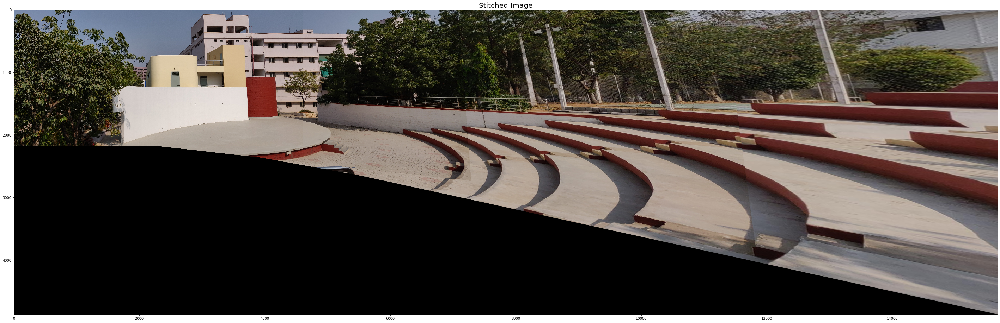

In [9]:
# Image 1 examples
images = []
subtitles = []
img1 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img1_1.jpg'), cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img1_2.jpg'), cv2.COLOR_BGR2RGB)
img3 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img1_3.jpg'), cv2.COLOR_BGR2RGB)
img4 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img1_4.jpg'), cv2.COLOR_BGR2RGB)

pts1, pts2 = findMatches(img3, img4, 0.6)
M_hom = RANSAC_Homography(pts2, pts1, 6)
img = stitch(img3, img4, M_hom)

pts1, pts2 = findMatches(img2, img, 0.6)
M_hom = RANSAC_Homography(pts2, pts1, 6)
img = stitch(img2, img, M_hom)

pts1, pts2 = findMatches(img1, img, 0.6)
M_hom = RANSAC_Homography(pts2, pts1, 6)
img = stitch(img1, img, M_hom)

images.append(img)
subtitles.append('Stitched Image')
display_images(images, 1, 1, (50, 50), '', subtitles)

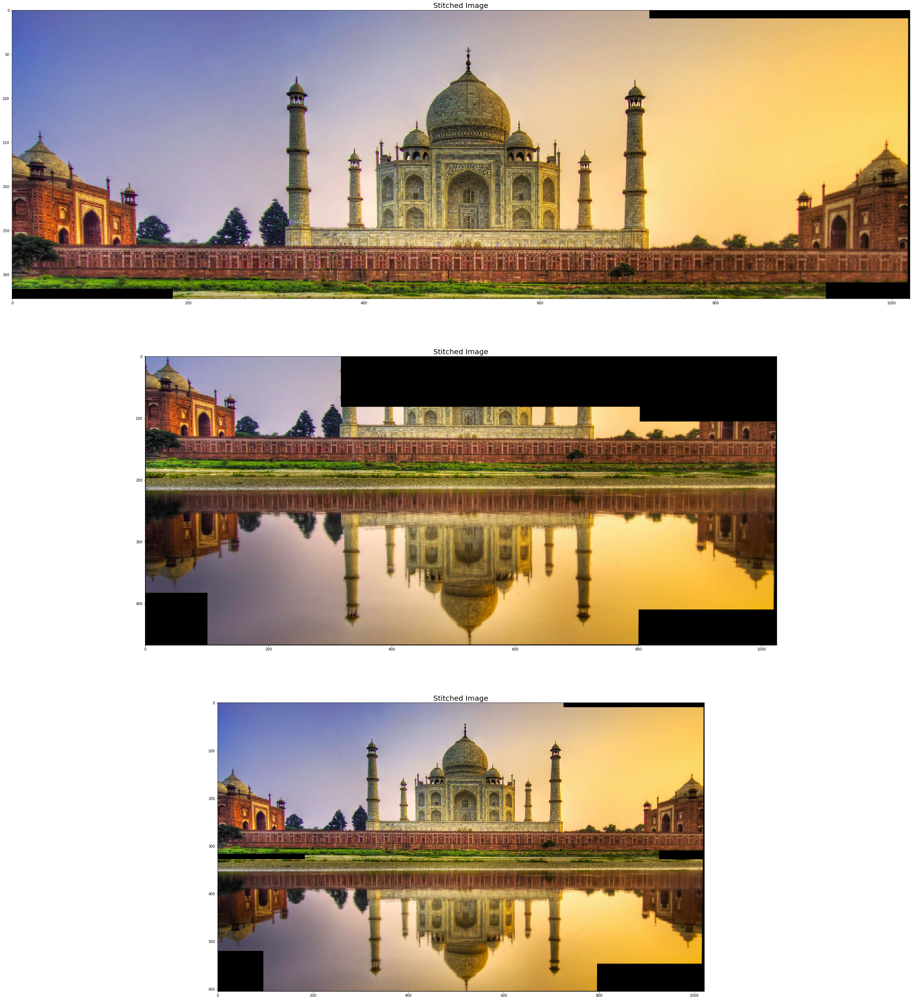

In [10]:
# Image 2 examples
images = []
subtitles = []
img1 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img2_1.png'), cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img2_2.png'), cv2.COLOR_BGR2RGB)
img3 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img2_3.png'), cv2.COLOR_BGR2RGB)
img4 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img2_4.png'), cv2.COLOR_BGR2RGB)
img5 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img2_5.png'), cv2.COLOR_BGR2RGB)
img6 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img2_6.png'), cv2.COLOR_BGR2RGB)

pts1, pts2 = findMatches(img2, img3)
M_hom = RANSAC_Homography(pts2, pts1, 30)
img = stitch(img2, img3, M_hom)

pts1, pts2 = findMatches(img1, img)
M_hom = RANSAC_Homography(pts2, pts1, 30)
img_top = stitch(img1, img, M_hom)

pts1, pts2 = findMatches(img5, img6)
M_hom = RANSAC_Homography(pts2, pts1, 30)
img_bottom = stitch(img5, img6, M_hom)

pts1, pts2 = findMatches(img4, img_bottom)
M_hom = RANSAC_Homography(pts2, pts1, 30)
img_bottom = stitch(img4, img_bottom, M_hom)

pts1, pts2 = findMatches(img_top, img_bottom)
M_hom = RANSAC_Homography(pts2, pts1, 10)
img = stitch(img_top, img_bottom, M_hom)

images.append(img_top)
subtitles.append('Stitched Image')
images.append(img_bottom)
subtitles.append('Stitched Image')
images.append(img)
subtitles.append('Stitched Image')
display_images(images, 3, 1, (50, 50), '', subtitles)

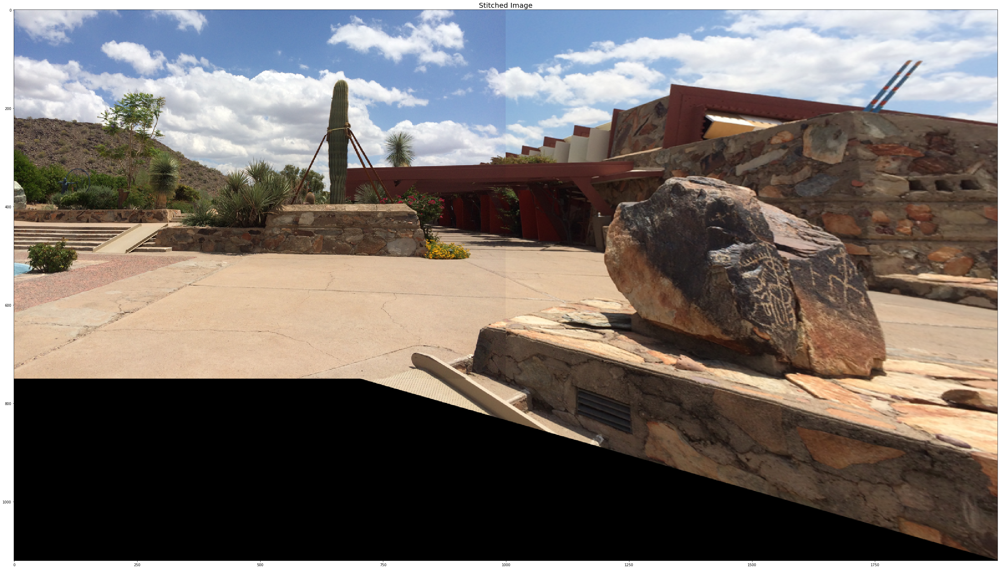

In [11]:
# Image 3 examples
images = []
subtitles = []
img1 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img3_1.png'), cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img3_2.png'), cv2.COLOR_BGR2RGB)

pts1, pts2 = findMatches(img1, img2, 0.75)
M_hom = RANSAC_Homography(pts2, pts1, no_of_points=10)
img_top = stitch(img1, img2, M_hom)

images.append(img_top)
subtitles.append('Stitched Image')
display_images(images, 1, 1, (50, 50), '', subtitles)

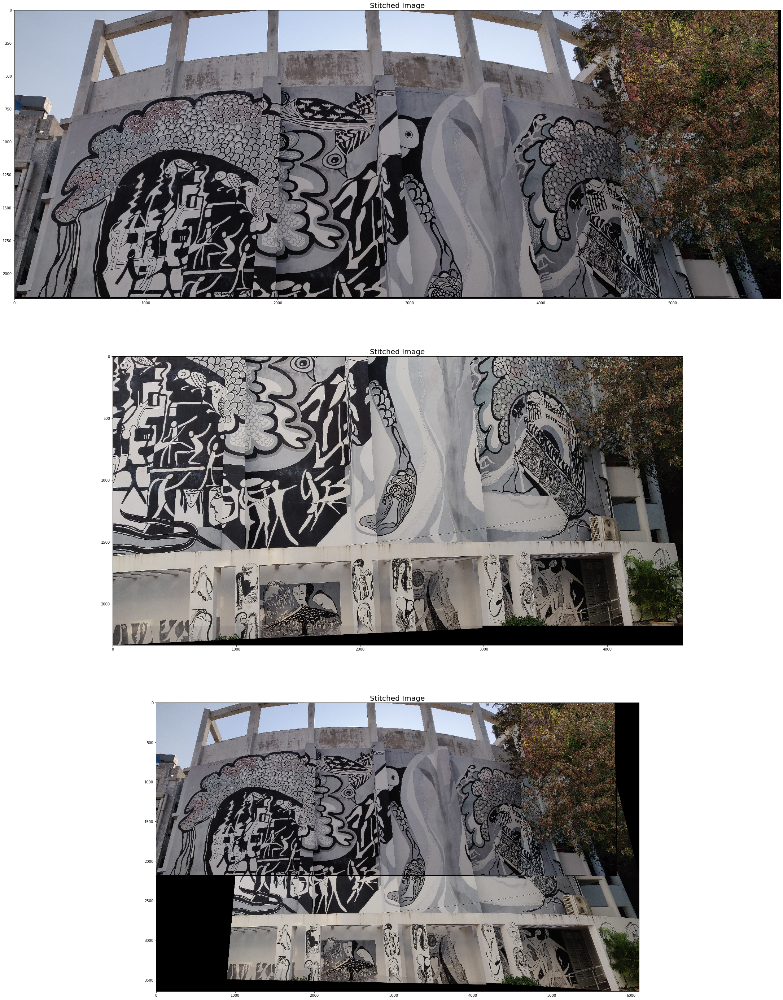

In [12]:
# Image 5 examples
images = []
subtitles = []
img1 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img5_1.jpg'), cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img5_2.jpg'), cv2.COLOR_BGR2RGB)
img3 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img5_3.jpg'), cv2.COLOR_BGR2RGB)
img4 = cv2.cvtColor(cv2.imread('../input_data/image_mosaicing/img5_4.jpg'), cv2.COLOR_BGR2RGB)

pts1, pts2 = findMatches(img1, img2, 0.75)
M_hom = RANSAC_Homography(pts2, pts1, no_of_points=10)
img_top = stitch(img1, img2, M_hom)
images.append(img_top)
subtitles.append('Stitched Image')

pts1, pts2 = findMatches(img3, img4, 0.75)
M_hom = RANSAC_Homography(pts2, pts1, no_of_points=10)
img_bottom = stitch(img3, img4, M_hom)
images.append(img_bottom)
subtitles.append('Stitched Image')

pts1, pts2 = findMatches(img_top, img_bottom, 0.75)
M_hom = RANSAC_Homography(pts2, pts1, no_of_points=15)
img = stitch(img_top, img_bottom, M_hom)
images.append(img)
subtitles.append('Stitched Image')

display_images(images, 3, 1, (50, 50), '', subtitles)

# Question 2

In [9]:
def plot_matching(img, pts1, pts2, offset = 0):
    if offset == 0:
        offset = int(img.shape[1] / 2)
    for i in range(pts1.shape[0]):
        cv2.line(img, (int(pts1[i][1]), int(pts1[i][0])), (int(pts2[i][1]) + offset, int(pts2[i][0])), (255, 0, 0), 1)
        cv2.circle(img, (int(pts1[i][1]), int(pts1[i][0])), 1, (255, 0, 0), 4)
        cv2.circle(img, (int(pts2[i][1]) + offset, int(pts2[i][0])), 1, (255, 0, 0), 4)

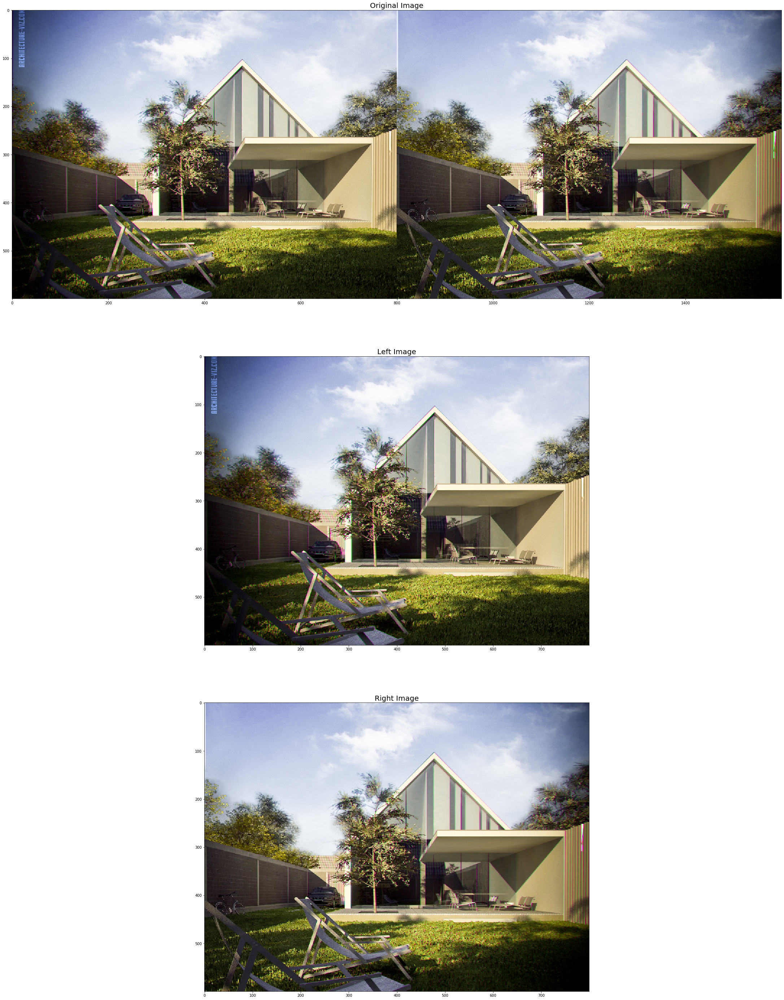

In [10]:
import copy
images = []
subtitles = []
img = cv2.cvtColor(cv2.imread('../input_data/stereo_images/1.jpg'), cv2.COLOR_BGR2RGB)
images.append(img)
subtitles.append('Original Image')

img1 = img[:, 0 : int(img.shape[1] / 2), :]
img2 = img[:, int(img.shape[1] / 2) : , :]

images.append(img1)
subtitles.append('Left Image')
images.append(img2)
subtitles.append('Right Image')

display_images(images, 3, 1, (50, 50), '', subtitles)

## Intensity based Matching

In [11]:
def similarity(v1,v2):
    if np.sqrt(v1.T.dot(v1)) == 0:
        return -1
    return v1.T.dot(v2)/(np.sqrt(v1.T.dot(v1))*np.sqrt(v2.T.dot(v2)))

In [12]:
def getMatch(img, patch, stride = 1):
    img = img.astype(np.float64)
    patch = patch.astype(np.float64)
    sz = patch.shape[0]
    bestVal = 0
    pos = -1
    c = 0
    for i in range(int(sz / 2), img.shape[0] - int(sz / 2), stride):
        similar = 0
        for j in range(int(sz / 2), img.shape[1] - int(sz / 2), stride):
            if j == int(sz / 2):
                v = img[i - int(sz / 2): i + int(sz / 2) + 1, j - int(sz / 2): j + int(sz / 2) + 1].flatten()
                v = v - np.mean(v)
                p = patch.flatten() - np.mean(patch.flatten())
                similar = max(similar, similarity(v, p))
            else:
                v = img[i - int(sz / 2): i + int(sz / 2) + 1, j - int(sz / 2): j + int(sz / 2) + 1].flatten()
                v = v - np.mean(v)
                p = patch.flatten() - np.mean(patch.flatten())
                similar = max(similar, similarity(v, p))
            if bestVal < similar:
                bestVal = similar
                pos = [i, j]
    return pos

In [13]:
def intensityBasedMatching(img1, img2, pts1, neighbourhood):
    pts2 = []
    for i in range(pts1.shape[0]):
        pts2.append(getMatch(img2, img1[pts1[i][0] - int(neighbourhood / 2): pts1[i][0] + int(neighbourhood / 2) + 1, pts1[i][1] - int(neighbourhood / 2): pts1[i][1] + int(neighbourhood / 2) + 1]))
    pts2 = np.asarray(pts2)
    return pts1, pts2

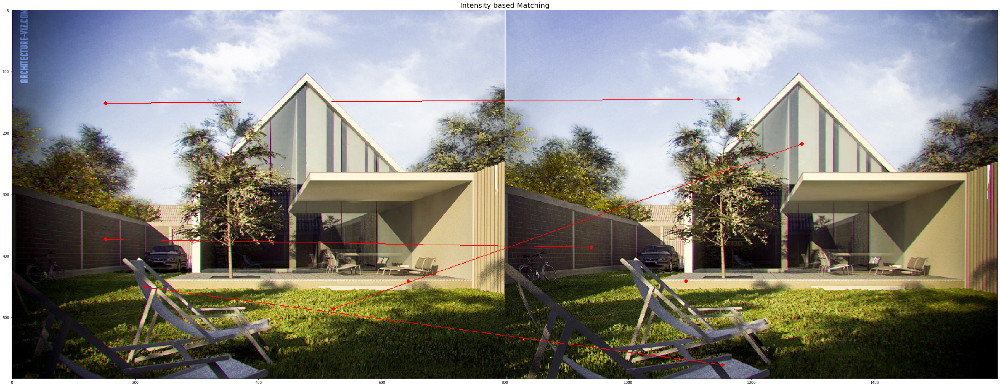

In [14]:
img = cv2.cvtColor(cv2.imread('../input_data/stereo_images/1.jpg'), cv2.COLOR_BGR2RGB)
img1 = img[:, 0 : int(img.shape[1] / 2), :]
img2 = img[:, int(img.shape[1] / 2) : , :]

neighbourhood = 5

pts1 = np.array([[152, 152], [441, 643], [486, 522], [451, 216], [373, 152]])
pts1, pts2 = intensityBasedMatching(img1, img2, pts1, 5)

images = []
subtitles = []
plot_img = copy.deepcopy(img)
plot_matching(plot_img, pts1, pts2)
images.append(plot_img)
subtitles.append('Intensity based Matching')
display_images(images, 1, 1, (50, 50), '', subtitles)

## Dense SIFT Based Matching (BONUS!)

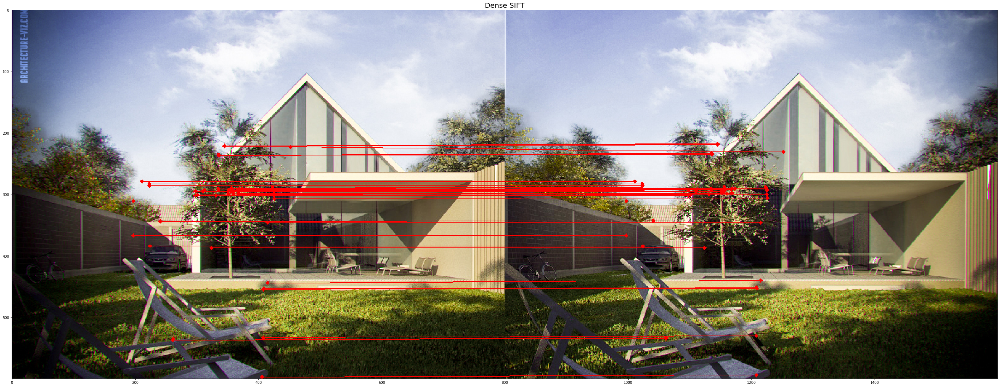

In [15]:
img = cv2.cvtColor(cv2.imread('../input_data/stereo_images/1.jpg'), cv2.COLOR_BGR2RGB)
img1 = img[:, 0 : int(img.shape[1] / 2), :]
img2 = img[:, int(img.shape[1] / 2) : , :]
images = []
subtitles = []
# Dense SIFT based Matching
dense_sift_matching = copy.deepcopy(img)
pts1, pts2 = findMatches(img1, img2)
plot_matching(dense_sift_matching, pts1, pts2)
images.append(dense_sift_matching)
subtitles.append('Dense SIFT')
display_images(images, 1, 1, (50, 50), '', subtitles)

## Image Rectification

In [16]:
def rectifyImages(img1, img2, pts1, pts2):
    F, mask = cv2.findFundamentalMat(pts1, pts2, cv2.RANSAC)
    pts1 = pts1[mask.ravel() == 1]
    pts2 = pts2[mask.ravel() == 1]
    img_size = (img1.shape[1], img1.shape[0])
    P, H1, H2 = cv2.stereoRectifyUncalibrated(pts1, pts2, F, img_size)
    
    img1_corrected = cv2.warpPerspective(img1, H1, img_size)
    img2_corrected = cv2.warpPerspective(img2, H2, img_size)
    return img1_corrected, img2_corrected

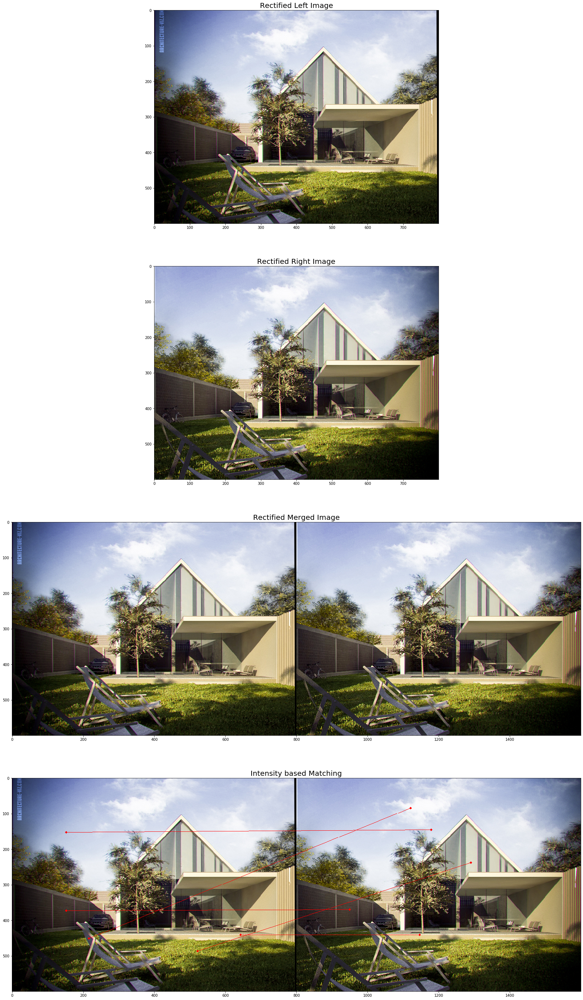

In [17]:
img = cv2.cvtColor(cv2.imread('../input_data/stereo_images/1.jpg'), cv2.COLOR_BGR2RGB)
img1 = img[:, 0 : int(img.shape[1] / 2), :]
img2 = img[:, int(img.shape[1] / 2) : , :]
pts1, pts2 = findMatches(img1, img2, 0.6)
images = []
subtitles = []
img1, img2 = rectifyImages(img1, img2, pts1, pts2)
images.append(img1)
subtitles.append('Rectified Left Image')
images.append(img2)
subtitles.append('Rectified Right Image')

img = np.zeros((max(img1.shape[0], img2.shape[0]), img1.shape[1] + img2.shape[1], 3))
img = img.astype(np.uint8)
img[0:img1.shape[0], 0:img1.shape[1], :] = img1
img[0:img2.shape[0], img1.shape[1]:, :] = img2
images.append(img)
subtitles.append('Rectified Merged Image')

pts1 = np.array([[152, 152], [441, 643], [486, 522], [451, 216], [373, 152]])
pts1, pts2 = intensityBasedMatching(img1, img2, pts1, 5)
plot_img = copy.deepcopy(img)
plot_matching(plot_img, pts1, pts2)
images.append(plot_img)
subtitles.append('Intensity based Matching')

display_images(images, 4, 1, (50, 50), '', subtitles)

## Greedily Intensity based Matching

In [18]:
def plot_matching_greedy(img, pts1, pts2, offset = 0, sz = 8):
    if offset == 0:
        offset = int(img.shape[1] / 2)
    for i in range(pts1.shape[0]):
        color = (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
        cv2.line(img, (int(pts1[i][1]), int(pts1[i][0])), (int(pts2[i][1]) + offset, int(pts2[i][0])), (255, 0, 0), 1)
        cv2.circle(img, (int(pts1[i][1]), int(pts1[i][0])), 1, color, sz)
        cv2.circle(img, (int(pts2[i][1]) + offset, int(pts2[i][0])), 1, color, sz)

In [19]:
def getGreedyMatch(img, patch, st_idx, row, stride = 1):
    img = img.astype(np.float64)
    patch = patch.astype(np.float64)
    sz = patch.shape[0]
    bestVal = 0
    pos = -1
    c = 0
    for i in range(row, row + 1):
        similar = 0
        for j in range(st_idx, img.shape[1] - int(sz / 2), stride):
            v = img[i - int(sz / 2): i + int(sz / 2) + 1, j - int(sz / 2): j + int(sz / 2) + 1].flatten()
            v = v - np.mean(v)
            p = patch.flatten() - np.mean(patch.flatten())
            similar = max(similar, similarity(v, p))
            
            if bestVal < similar:
                bestVal = similar
                pos = [i, j]
    return pos

In [25]:
def greedilyIntensityBasedMatching(img1, img2, neighbourhood, row_stride = 100, col_stride = 100):
    pts2 = []
    pts1 = []
    for i in range(int(neighbourhood / 2), img1.shape[0] - int(neighbourhood / 2), row_stride):
        threshold = int(neighbourhood / 2)
        for j in range(int(neighbourhood / 2), img1.shape[1] - int(neighbourhood / 2), col_stride):
            r = i
            c = j
            if(img1[r][c][0] == 0 and img1[r][c][1] == 0 and img1[r][c][2] == 0):
                continue
            correspondence = getGreedyMatch(img2, img1[r - int(neighbourhood / 2) : r + int(neighbourhood / 2) + 1, c - int(neighbourhood / 2): c + int(neighbourhood / 2) + 1], threshold, r)
            try:
                k = correspondence[0]
            except:
                continue
            pts2.append(correspondence)
            pts1.append([r, c])
            threshold = correspondence[1] + 1
    pts2 = np.asarray(pts2)
    pts1 = np.asarray(pts1)
    return pts1, pts2

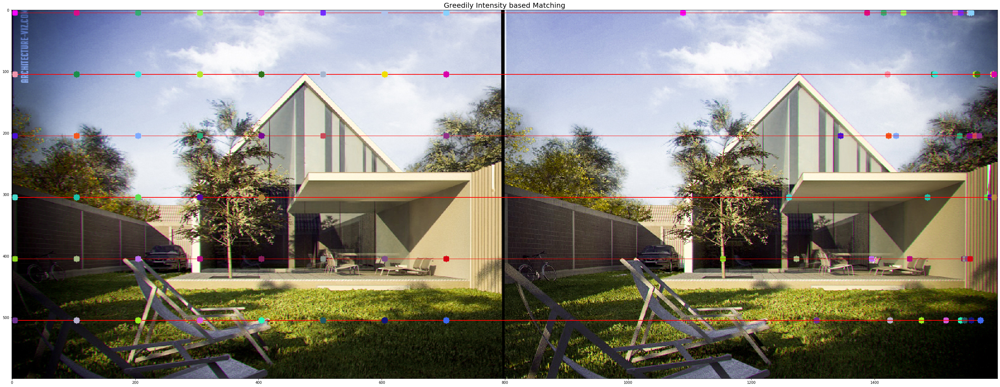

In [21]:
img = cv2.cvtColor(cv2.imread('../input_data/stereo_images/1.jpg'), cv2.COLOR_BGR2RGB)
img1 = img[:, 0 : int(img.shape[1] / 2), :]
img2 = img[:, int(img.shape[1] / 2) : , :]
pts1, pts2 = findMatches(img1, img2, 0.6)
images = []
subtitles = []
img1, img2 = rectifyImages(img1, img2, pts1, pts2)

img = np.zeros((max(img1.shape[0], img2.shape[0]), img1.shape[1] + img2.shape[1], 3))
img = img.astype(np.uint8)
img[0:img1.shape[0], 0:img1.shape[1], :] = img1
img[0:img2.shape[0], img1.shape[1]:, :] = img2

pts1 = np.array([373])
pts1, pts2 = greedilyIntensityBasedMatching(img1, img2, 11)
plot_img = copy.deepcopy(img)
plot_matching_greedy(plot_img, pts1, pts2)
images.append(plot_img)
subtitles.append('Greedily Intensity based Matching')

display_images(images, 1, 1, (50, 50), '', subtitles)

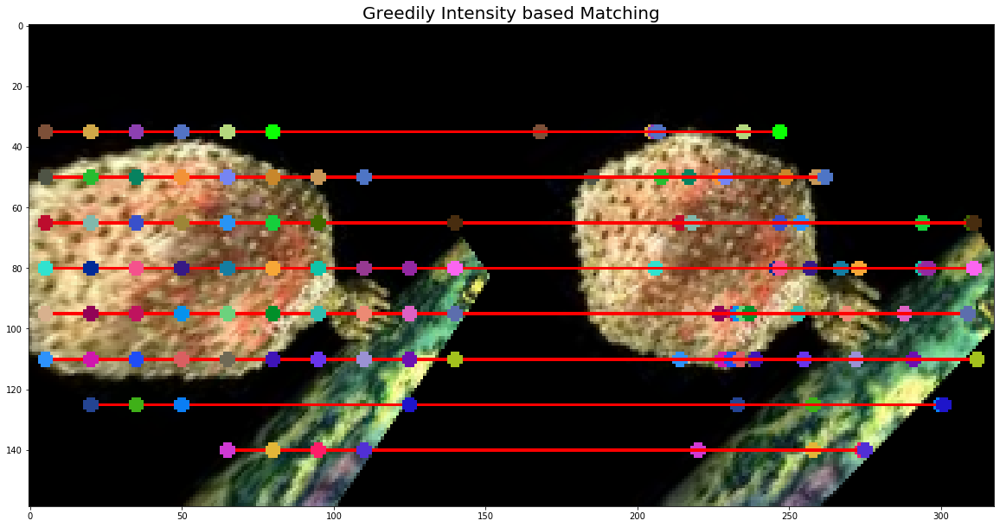

In [23]:
img = cv2.cvtColor(cv2.imread('../input_data/stereo_images/3.jpeg'), cv2.COLOR_BGR2RGB)
img1 = img[:, 0 : int(img.shape[1] / 2), :]
img2 = img[:, int(img.shape[1] / 2) : , :]
pts1, pts2 = findMatches(img1, img2, 0.5)
images = []
subtitles = []
img1, img2 = rectifyImages(img1, img2, pts1, pts2)

img = np.zeros((max(img1.shape[0], img2.shape[0]), img1.shape[1] + img2.shape[1], 3))
img = img.astype(np.uint8)
img[0:img1.shape[0], 0:img1.shape[1], :] = img1
img[0:img2.shape[0], img1.shape[1]:, :] = img2

pts1, pts2 = greedilyIntensityBasedMatching(img1, img2, 10, 15, 15)
plot_img = copy.deepcopy(img)
plot_matching_greedy(plot_img, pts1, pts2, sz=2)
images.append(plot_img)
subtitles.append('Greedily Intensity based Matching')

display_images(images, 1, 1, (20, 20), '', subtitles)

## Dynamic Programming Intensity based Matching

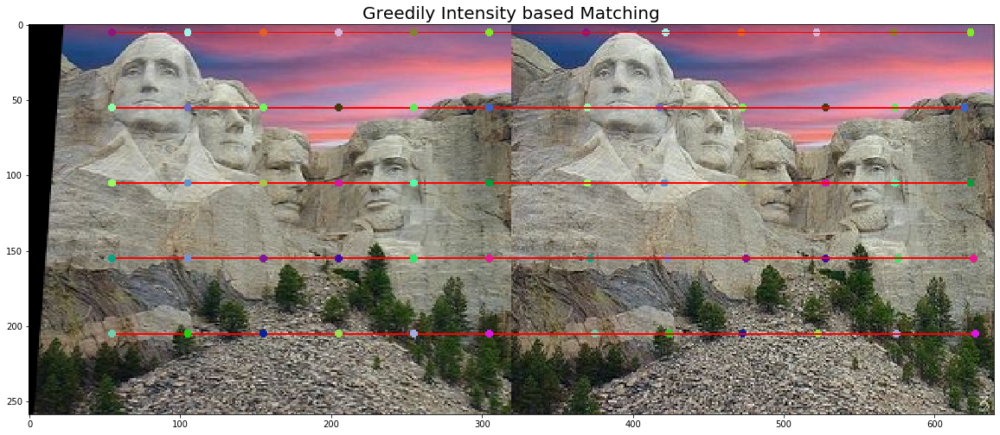

In [27]:
img = cv2.cvtColor(cv2.imread('../input_data/stereo_images/2.jpg'), cv2.COLOR_BGR2RGB)
img1 = img[:, 0 : int(img.shape[1] / 2), :]
img2 = img[:, int(img.shape[1] / 2) : , :]
pts1, pts2 = findMatches(img1, img2, 0.5)
images = []
subtitles = []
img1, img2 = rectifyImages(img1, img2, pts1, pts2)

img = np.zeros((max(img1.shape[0], img2.shape[0]), img1.shape[1] + img2.shape[1], 3))
img = img.astype(np.uint8)
img[0:img1.shape[0], 0:img1.shape[1], :] = img1
img[0:img2.shape[0], img1.shape[1]:, :] = img2

pts1, pts2 = greedilyIntensityBasedMatching(img1, img2, 10, 50, 50)
plot_img = copy.deepcopy(img)
plot_matching_greedy(plot_img, pts1, pts2, sz=2)
images.append(plot_img)
subtitles.append('Greedily Intensity based Matching')

display_images(images, 1, 1, (20, 20), '', subtitles)